# **1. Import and Install Dependencies**

## **1.1 Install Dependencies**

In [ ]:
pip install tensorflow==2.13.0

In [ ]:
#pip install tensorboard==2.13.0

In [ ]:
!pip install tensorflow-io matplotlib

## **1.2 Load Dependencies**

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Embedding, MultiHeadAttention, LayerNormalization, Dropout, Dense
from tensorflow.keras.models import Sequential
print(f'TensorFlow Version {tf.__version__}')

TensorFlow Version 2.13.0


In [ ]:
import os
import matplotlib.pyplot as plt
import tensorflow_io as tfio
import numpy as np
import datetime
import librosa

In [ ]:
# Load the TensorBoard notebook extension
#%reload_ext tensorboard

In [ ]:
# Clear any logs from previous runs
#!rm -rf ./logs/

# **2. Build Data Loading Function**

## **2.1 Define Paths to Files**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls

drive  sample_data


In [ ]:
DUSKUS_GODS = os.path.join('drive', 'MyDrive', 'Data', 'Songs', 'Duskus - Gods.wav')

## **2.2 Build Dataloading Function**

In [ ]:
def load_wav_mono(filename):
  # Load encoded wav file
  file_contents = tf.io.read_file(filename)
  # Decode wav (tensors by channels)
  wav, sample_rate = tf.audio.decode_wav(file_contents, desired_channels=1)
  # Removes trailing axis
  wav = tf.squeeze(wav, axis=-1)
  sample_rate = tf.cast(sample_rate, dtype=tf.int64)
  # Goes from 48000Hz to 48000hz - amplitude of the audio signal
  wav = tfio.audio.resample(wav, rate_in=sample_rate, rate_out=sample_rate)
  print(sample_rate)
  return wav

## **2.3 Plot Wave**

In [ ]:
wave1 = load_wav_mono(DUSKUS_GODS)

tf.Tensor(48000, shape=(), dtype=int64)


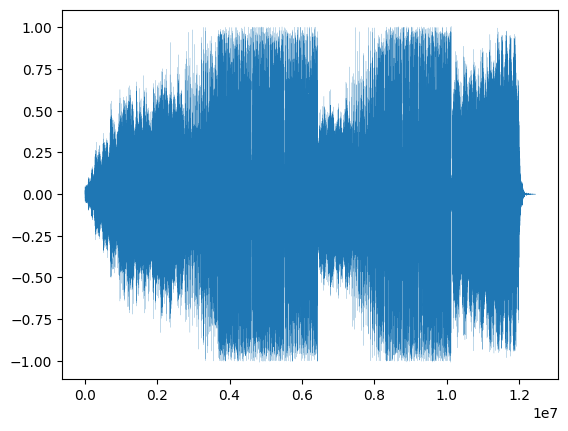

In [ ]:
plt.plot(wave1, linewidth=0.1)
plt.show()

# **3. Create Tensorflow Dataset**

## **3.1 Define Paths to Data**

In [ ]:
MUSIC_DATA_PATH = os.path.join('drive', 'MyDrive', 'Data', 'Songs')

## **3.2 Create Tensorflow Datasets**

In [ ]:
SONG_FILE_PATHS = tf.data.Dataset.list_files(MUSIC_DATA_PATH+'/*.wav')

In [ ]:
# Create an iterator for the dataset
iterator = iter(SONG_FILE_PATHS)

# Get the first element
first_element = next(iterator)

# Convert it to a string
first_element_path = first_element.numpy().decode('utf-8')

# Now you have the path to the first element in the dataset
print(first_element_path)

drive/MyDrive/Data/Songs/Truth Be Told (pronouncedyea Remix).wav


# **4. Determine BPMs of Songs**

In [ ]:
BPMs = []
for file in os.listdir(os.path.join('drive', 'MyDrive', 'Data', 'Songs')):
  y, sr = librosa.load(os.path.join('drive', 'MyDrive', 'Data', 'Songs', file))
  tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
  BPMs.append(tempo)

In [ ]:
del librosa

# **5. Build Preprocessing Function to Convert to Spectrogram**

## **5.1 Build Preprocessing Function**

In [ ]:
def preprocess(file_path):
    wav = load_wav_mono(file_path)
    spectrogram = tf.signal.stft(wav, frame_length=320, frame_step=32)
    spectrogram = tf.abs(spectrogram)
    spectrogram = tf.expand_dims(spectrogram, axis=2)
    return spectrogram

In [ ]:
positives = tf.data.Dataset.zip((SONG_FILE_PATHS))

tf.Tensor(48000, shape=(), dtype=int64)


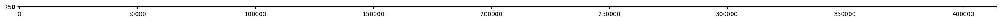

In [ ]:
# Define the dataset
positives = tf.data.Dataset.list_files(MUSIC_DATA_PATH+'/*.wav')

# Shuffle the dataset and take one item
sample = positives.shuffle(buffer_size=10000).take(1)

# Iterate through the dataset
for filepath in sample:
  # Convert the filepath to a string
  filepath = filepath.numpy().decode('utf-8')

  # Call the preprocess function on the file
  spectrogram = preprocess(filepath)  # Assuming label is defined elsewhere

  # Visualize the spectrogram
  plt.figure(figsize=(30, 20))
  plt.imshow(tf.transpose(spectrogram)[0])
  plt.show()

In [ ]:
spectrogram = preprocess(filepath)

tf.Tensor(48000, shape=(), dtype=int64)


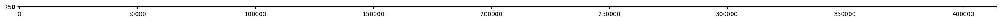

In [ ]:
plt.figure(figsize=(30,20))
plt.imshow(tf.transpose(spectrogram)[0])
plt.show()

In [ ]:
# Input time-domain signal
signal = wave1

# Compute the STFT
frame_length = 20000  # Adjust frame length as needed
frame_step = 1000    # Adjust frame step as needed
stft = tf.signal.stft(signal, frame_length=frame_length, frame_step=frame_step)

# Reconstruct the original signal from the STFT
reconstructed_signal = tf.signal.inverse_stft(stft, frame_length=frame_length, frame_step=frame_step)

# Verify the similarity between the original and reconstructed signals
#error = tf.reduce_max(tf.abs(signal - reconstructed_signal))
#print("Reconstruction error:", error.numpy())

## **5.2 Preview Reconstructed Audio**

In [ ]:
from IPython.display import Audio, display

In [ ]:
"""# Convert the reconstructed signal tensor to a NumPy array
reconstructed_signal_np = reconstructed_signal.numpy()

# Play the audio
display(Audio(reconstructed_signal_np, rate=48000, autoplay=True))"""

'# Convert the reconstructed signal tensor to a NumPy array\nreconstructed_signal_np = reconstructed_signal.numpy()\n\n# Play the audio\ndisplay(Audio(reconstructed_signal_np, rate=48000, autoplay=True))'

In [ ]:
del Audio, display

# **6. Tokenize STFT Data**

## **6.1 STFT Params**

In [ ]:
FRAME_LENGTH = 10000
FRAME_STEP = 2000

In [ ]:
song = 0

## **6.2 Extract Y(t) and Convert to I(f, t)**

### **6.2.1 STFT**

In [ ]:
Data_Y = []
Data_ft = []

for path in positives:
  wav = load_wav_mono(path)
  Data_Y.append(wav.numpy())
  spectrogram = tf.abs(tf.signal.stft(wav, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))
  Data_ft.append(spectrogram.numpy())

tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)
tf.Tensor(48000, shape=(), dtype=int64)


In [ ]:
numTimes, numFreqs = np.shape(Data_ft[song])
print(f'Times: {numTimes}')
print(f'Freqs: {numFreqs}')

Times: 4518
Freqs: 8193


Griffin-Lim Algorithm

In [ ]:
"""# Assuming you have the magnitude_stft and the number of iterations
magnitude_stft = Data_ft[song]
n_iter = 100  # Adjust the number of iterations as needed

# Initialize the phase randomly
phase = tf.random.uniform(shape=magnitude_stft.shape, minval=-np.pi, maxval=np.pi, dtype=tf.float32)

for i in range(n_iter):
    # Reconstruct complex data
    complex_data = tf.complex(magnitude_stft * tf.math.cos(phase), magnitude_stft * tf.math.sin(phase))

    # Perform inverse STFT with the current phase
    reconstructed_signal = tf.signal.inverse_stft(
        complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)

    # Update the phase using the angle of the reconstructed signal
    phase = tf.math.angle(tf.signal.stft(reconstructed_signal, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))

# The final reconstructed_signal should have less reverb-like effect"""

'# Assuming you have the magnitude_stft and the number of iterations\nmagnitude_stft = Data_ft[song]\nn_iter = 100  # Adjust the number of iterations as needed\n\n# Initialize the phase randomly\nphase = tf.random.uniform(shape=magnitude_stft.shape, minval=-np.pi, maxval=np.pi, dtype=tf.float32)\n\nfor i in range(n_iter):\n    # Reconstruct complex data\n    complex_data = tf.complex(magnitude_stft * tf.math.cos(phase), magnitude_stft * tf.math.sin(phase))\n\n    # Perform inverse STFT with the current phase\n    reconstructed_signal = tf.signal.inverse_stft(\n        complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)\n\n    # Update the phase using the angle of the reconstructed signal\n    phase = tf.math.angle(tf.signal.stft(reconstructed_signal, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))\n\n# The final reconstructed_signal should have less reverb-like effect'

### **6.2.2 Error**

In [ ]:
# Reconstruct the original signal from the STFT
song = 0
spectrogram = Data_ft[song]
phase = tf.math.angle(spectrogram)
real = spectrogram * tf.math.cos(phase)
imag = spectrogram * tf.math.sin(phase)
complex_data = tf.complex(real, imag)
reconstructed_signal = tf.signal.inverse_stft(
    complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)

In [ ]:
# Assuming 'signal' and 'reconstructed_rounded_signal' are your tensors
# Find the length difference
signal = tf.convert_to_tensor(Data_Y[song])
min_length = tf.minimum(tf.shape(signal)[0], tf.shape(reconstructed_signal)[0])

signal = signal[:min_length]
reconstructed_signal = reconstructed_signal[:min_length]

# Verify the similarity between the original and reconstructed signals
error = tf.reduce_max(tf.abs(signal - reconstructed_signal))
print("Reconstruction error:", error.numpy())

Reconstruction error: 1.4312055


### **6.2.3 Pure Reconstruction Audio Quality - EAR TEST**

In [ ]:
from IPython.display import Audio, display

In [ ]:
"""# Convert the reconstructed signal tensor to a NumPy array
reconstructed_signal_np = reconstructed_signal.numpy()

# Play the audio
display(Audio(reconstructed_signal_np, rate=48000, autoplay=True))"""

'# Convert the reconstructed signal tensor to a NumPy array\nreconstructed_signal_np = reconstructed_signal.numpy()\n\n# Play the audio\ndisplay(Audio(reconstructed_signal_np, rate=48000, autoplay=True))'

In [ ]:
del Audio, display

## **6.3 Round I(f, t) and Remove Zeros**

### **6.3.1 Round**

In [ ]:
def round_to_n(x, n):
    # Handle very small values to avoid division by zero
    small_value_indices = np.abs(x) < 1e-15
    x[small_value_indices] = 0.0

    # Calculate the factor only for non-zero values to avoid division by zero
    non_zero_indices = np.abs(x) > 0
    factor = np.zeros_like(x)
    factor[non_zero_indices] = 10 ** (n - np.floor(np.log10(np.abs(x[non_zero_indices]))) - 1)

    # Round the number to n digits, set division to zero explicitly for small values
    with np.errstate(divide='ignore', invalid='ignore'):
        rounded_x = np.round(x * factor) / np.where(factor != 0, factor, 1)

    return rounded_x

In [ ]:
sigfigs = 1
Rounded_Data_ft = [
    round_to_n(array, sigfigs)
    for array in Data_ft
]

### **6.3.2 Zero Out Insignificant Values**

In [ ]:
np.average(Rounded_Data_ft[song])

6.613517

In [ ]:
# Your threshold value
threshold = 20   # Adjust as needed

# Iterate through the list of 2D arrays
for array in Rounded_Data_ft:
    # Convert the complex array to a NumPy array
    np_array = np.array(array)

    # Create a mask for values that meet the condition
    mask = np_array < threshold

    # Set real and imaginary parts to 0 for elements that meet the condition
    np_array[mask] = 0

    # Update the original complex_array with the modified NumPy array
    array[:] = np_array

Time-Saving Method

In [ ]:
# Reconstruct the original signal from the STFT
song = 0
spectrogram = Rounded_Data_ft[song]
phase = tf.math.angle(spectrogram)
real = spectrogram * tf.math.cos(phase)
imag = spectrogram * tf.math.sin(phase)
complex_data = tf.complex(real, imag)
reconstructed_signal = tf.signal.inverse_stft(
    complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)

Griffin-Lim Algorithm for Higher Quality

In [ ]:
# Assuming you have the magnitude_stft and the number of iterations
magnitude_stft = Rounded_Data_ft[song]
n_iter = 100  # Adjust the number of iterations as needed

# Initialize the phase randomly
phase = tf.random.uniform(shape=magnitude_stft.shape, minval=-np.pi, maxval=np.pi, dtype=tf.float32)

for i in range(n_iter):
    # Reconstruct complex data
    complex_data = tf.complex(magnitude_stft * tf.math.cos(phase), magnitude_stft * tf.math.sin(phase))

    # Perform inverse STFT with the current phase
    reconstructed_signal = tf.signal.inverse_stft(
        complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)

    # Update the phase using the angle of the reconstructed signal
    phase = tf.math.angle(tf.signal.stft(reconstructed_signal, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))

# The final reconstructed_signal should have less reverb-like effect

### **6.3.3 Error**

In [ ]:
"""# Reconstruct the original signal from the STFT
reconstructed_rounded_signal = tf.signal.inverse_stft(Rounded_Data_ft[0], frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)"""

'# Reconstruct the original signal from the STFT\nreconstructed_rounded_signal = tf.signal.inverse_stft(Rounded_Data_ft[0], frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)'

In [ ]:
"""# Assuming 'signal' and 'reconstructed_rounded_signal' are your tensors
# Find the length difference
signal = tf.constant(Data_Y[song])
min_length = min(tf.shape(signal)[0], tf.shape(reconstructed_rounded_signal)[0])

signal = signal[:min_length]
reconstructed_rounded_signal = reconstructed_rounded_signal[:min_length]

# Verify the similarity between the original and reconstructed signals
error = tf.reduce_max(tf.abs(signal - reconstructed_rounded_signal))
print("Reconstruction error:", error.numpy())"""

'# Assuming \'signal\' and \'reconstructed_rounded_signal\' are your tensors\n# Find the length difference\nsignal = tf.constant(Data_Y[song])\nmin_length = min(tf.shape(signal)[0], tf.shape(reconstructed_rounded_signal)[0])\n\nsignal = signal[:min_length]\nreconstructed_rounded_signal = reconstructed_rounded_signal[:min_length]\n\n# Verify the similarity between the original and reconstructed signals\nerror = tf.reduce_max(tf.abs(signal - reconstructed_rounded_signal))\nprint("Reconstruction error:", error.numpy())'

### **6.3.3 Rounded Reconstruction Audio Quality - EAR TEST**

In [ ]:
from IPython.display import Audio, display

In [ ]:
# Convert the reconstructed signal tensor to a NumPy array
reconstructed_signal_np = reconstructed_signal.numpy()

# Play the audio
display(Audio(reconstructed_signal_np, rate=48000, autoplay=True))

In [ ]:
del Audio, display

## **6.4 Create Token Database and Lists of Tokens**

In [ ]:
import concurrent.futures

# Initialize an empty set for tokens
Token_DB = set()
Token_Lists = []

# Define a function to process a single row and update Token_DB
def process_row(row):
    non_zero_indices = np.nonzero(row)[0]
    row_tokens = [f'F{index} I{intensity}' for index, intensity in zip(non_zero_indices, row[non_zero_indices])]
    Token_DB.update(row_tokens)
    return row_tokens

# Process the data in batches using a ThreadPoolExecutor
with concurrent.futures.ThreadPoolExecutor() as executor:
    array_tokens = list(executor.map(process_row, (row for array in Rounded_Data_ft for row in array)))

# Split the array_tokens into separate lists for each array
index = 0
for array in Rounded_Data_ft:
    Token_Lists.append(array_tokens[index:index + len(array)])
    index += len(array)

In [ ]:
del concurrent.futures

In [ ]:
list(Token_DB)[0]

'F4608 I40.0'

In [ ]:
np.shape(Data_ft[0])

(4518, 8193)

In [ ]:
# Initialize a list to store the counts for each complex array
average_tokens_per_row = []

# Iterate through the list of lists of tokens (Token_Lists)
for array_tokens in Token_Lists:
    # Calculate the average number of tokens per row for the current complex array
    average = np.mean([len(row_tokens) for row_tokens in array_tokens])
    average_tokens_per_row.append(average)

# Calculate the overall average
overall_average = np.mean(average_tokens_per_row)

# Print the average for each complex array and the overall average
for i, average in enumerate(average_tokens_per_row):
    print(f"Average number of tokens per row for complex array {i}: {int(round(average, 0))}")
print("Overall average number of tokens per row:", int(round(overall_average, 0)))

Average number of tokens per row for complex array 0: 827
Average number of tokens per row for complex array 1: 462
Average number of tokens per row for complex array 2: 422
Average number of tokens per row for complex array 3: 952
Average number of tokens per row for complex array 4: 962
Average number of tokens per row for complex array 5: 313
Average number of tokens per row for complex array 6: 670
Average number of tokens per row for complex array 7: 773
Average number of tokens per row for complex array 8: 533
Average number of tokens per row for complex array 9: 365
Average number of tokens per row for complex array 10: 736
Average number of tokens per row for complex array 11: 171
Average number of tokens per row for complex array 12: 553
Average number of tokens per row for complex array 13: 1026
Average number of tokens per row for complex array 14: 564
Average number of tokens per row for complex array 15: 402
Average number of tokens per row for complex array 16: 1046
Avera

In [ ]:
numSamples = 0

for complex_array in Rounded_Data_ft:
  numTimes, numFreqs = np.shape(complex_array)
  numIntensities = numTimes * numFreqs
  numSamples += numIntensities

numTokens = len(Token_DB)

print(f'Number of Original Samples: {numSamples}')
print(f'Number of Unique Tokens: {numTokens}')
print(f'Reduction Factor: {round(numSamples/numTokens, 2)} times reduction')

Number of Original Samples: 902172195
Number of Unique Tokens: 41653
Reduction Factor: 21659.24 times reduction


In [ ]:
padToken = 'PAD'
startToken = 'START'
timeStepToken = 'STEP'
beatToken = 'BEAT'

In [ ]:
Token_Indices = {}
Token_Indices[padToken] = 0
Token_Indices[startToken] = 1
Token_Indices[timeStepToken] = 2
Token_Indices[beatToken] = 3

for i, token in enumerate(Token_DB, 1):
    Token_Indices[token] = i

## **6.5 Generate Token Values and IDs**

In [ ]:
Indexed_Lists = [
  [
    [Token_Indices[token] for token in row]
    for row in token_list
  ]
  for token_list in Token_Lists
]

In [ ]:
Token_Lists[0][0]

['F2 I20.0',
 'F6 I20.0',
 'F7 I20.0',
 'F8 I20.0',
 'F9 I20.0',
 'F10 I30.0',
 'F11 I30.0',
 'F12 I20.0',
 'F13 I20.0',
 'F14 I60.0',
 'F15 I100.0',
 'F16 I200.0',
 'F17 I200.0',
 'F18 I300.0',
 'F19 I500.0',
 'F20 I600.0',
 'F21 I500.0',
 'F22 I500.0',
 'F23 I500.0',
 'F24 I500.0',
 'F25 I300.0',
 'F26 I200.0',
 'F27 I600.0',
 'F28 I800.0',
 'F29 I600.0',
 'F30 I300.0',
 'F31 I200.0',
 'F32 I300.0',
 'F33 I300.0',
 'F34 I200.0',
 'F35 I200.0',
 'F36 I500.0',
 'F37 I700.0',
 'F38 I700.0',
 'F39 I500.0',
 'F40 I100.0',
 'F41 I100.0',
 'F42 I300.0',
 'F43 I300.0',
 'F44 I400.0',
 'F45 I300.0',
 'F46 I200.0',
 'F47 I200.0',
 'F48 I100.0',
 'F49 I100.0',
 'F50 I100.0',
 'F51 I200.0',
 'F52 I200.0',
 'F53 I200.0',
 'F54 I200.0',
 'F55 I200.0',
 'F56 I100.0',
 'F57 I60.0',
 'F58 I80.0',
 'F59 I100.0',
 'F60 I100.0',
 'F61 I100.0',
 'F62 I200.0',
 'F63 I200.0',
 'F64 I100.0',
 'F65 I100.0',
 'F66 I40.0',
 'F67 I20.0',
 'F68 I50.0',
 'F69 I80.0',
 'F70 I80.0',
 'F71 I50.0',
 'F73 I50.0',
 'F7

In [ ]:
list(Token_Indices.keys())[0]

'PAD'

In [ ]:
Indexed_Lists[0][1]

[9617,
 11507,
 29583,
 35761,
 28958,
 21748,
 21870,
 16116,
 440,
 1619,
 14815,
 33740,
 1263,
 31195,
 40408,
 39432,
 36049,
 6596,
 6014,
 39850,
 18115,
 5029,
 10080,
 35457,
 24083,
 20844,
 30054,
 29600,
 38818,
 5321,
 35201,
 13943,
 20113,
 39172,
 11275,
 29312,
 1779,
 315,
 9585,
 13144,
 23831,
 5718,
 15451,
 41314,
 15934,
 20022,
 33933,
 31130,
 35236,
 1439,
 36980,
 30501,
 27785,
 11383,
 41466,
 31053,
 10108,
 6508,
 35767,
 2957,
 20507,
 3799,
 4695,
 41546,
 29222,
 17174,
 24709,
 18975,
 39045,
 15134,
 14978,
 32654,
 4208,
 32980,
 28047,
 4372,
 35754,
 21875,
 25999,
 88,
 19036,
 6863,
 24703,
 828,
 3325,
 21999,
 28933,
 28497,
 9245,
 9590,
 39073,
 8934,
 31142,
 33084,
 18156,
 40944,
 11390,
 26762,
 3207,
 16599,
 12435,
 40413,
 41199,
 19534,
 16617,
 1186,
 30633,
 2017,
 1821,
 40208,
 35181,
 33965,
 27678,
 10079,
 30783,
 22728,
 21733,
 20282,
 5890,
 4639,
 15750,
 27387,
 31557,
 5859,
 15920,
 4452,
 20704,
 30138,
 32214,
 9294,


## **6.6 Tokenize Full Song of Tokens**

In [ ]:
Song_Token_Labels = []

for song_list in Token_Lists:
  temp_song = []
  for row in song_list:
    temp_song.append(timeStepToken)
    temp_song.extend(row)
  Song_Token_Labels.append(temp_song)

In [ ]:
Song_Token_Labels[0][:50]

['STEP',
 'F2 I20.0',
 'F6 I20.0',
 'F7 I20.0',
 'F8 I20.0',
 'F9 I20.0',
 'F10 I30.0',
 'F11 I30.0',
 'F12 I20.0',
 'F13 I20.0',
 'F14 I60.0',
 'F15 I100.0',
 'F16 I200.0',
 'F17 I200.0',
 'F18 I300.0',
 'F19 I500.0',
 'F20 I600.0',
 'F21 I500.0',
 'F22 I500.0',
 'F23 I500.0',
 'F24 I500.0',
 'F25 I300.0',
 'F26 I200.0',
 'F27 I600.0',
 'F28 I800.0',
 'F29 I600.0',
 'F30 I300.0',
 'F31 I200.0',
 'F32 I300.0',
 'F33 I300.0',
 'F34 I200.0',
 'F35 I200.0',
 'F36 I500.0',
 'F37 I700.0',
 'F38 I700.0',
 'F39 I500.0',
 'F40 I100.0',
 'F41 I100.0',
 'F42 I300.0',
 'F43 I300.0',
 'F44 I400.0',
 'F45 I300.0',
 'F46 I200.0',
 'F47 I200.0',
 'F48 I100.0',
 'F49 I100.0',
 'F50 I100.0',
 'F51 I200.0',
 'F52 I200.0',
 'F53 I200.0']

In [ ]:
Song_Token_IDs = []

for song_list in Indexed_Lists:
  temp_song = []
  for row in song_list:
    temp_song.append(Token_Indices[timeStepToken])
    temp_song.extend(row)
  Song_Token_IDs.append(temp_song)

In [ ]:
Song_Token_IDs[0][:50]

[2,
 29583,
 22583,
 30263,
 22270,
 4600,
 10385,
 8346,
 37996,
 31916,
 21870,
 12239,
 32338,
 35806,
 19071,
 33740,
 39688,
 40747,
 30853,
 36127,
 12932,
 3969,
 41650,
 22327,
 12508,
 5029,
 20223,
 1381,
 24083,
 20844,
 36932,
 8282,
 10608,
 27992,
 32067,
 11321,
 1811,
 39172,
 39281,
 21016,
 30745,
 5141,
 2183,
 9731,
 7635,
 5761,
 15451,
 27573,
 18831,
 7501]

## **6.7 Byte-Pair Encoding**

In [ ]:
"""from collections import Counter

def bpe(lists, token_dict, iters, freq_min, special_token):
    for _ in range(iters):
        # Count token pairs in the input sequences efficiently using NumPy
        pair_counts = Counter()
        for sequence in lists:
            non_special_indices = np.where(sequence != special_token)[0]
            if len(non_special_indices) < 2:
                break  # No pairs to process
            pairs = list(zip(sequence[non_special_indices][:-1], sequence[non_special_indices][1:]))
            pair_counts.update(pairs)

        if not pair_counts:
            break  # No more pairs to merge

        max_pair, max_pair_count = pair_counts.most_common(1)[0]

        if max_pair_count < freq_min:
            break  # No more pairs to merge

        # Find the most frequent pair to merge
        new_token = len(token_dict)
        token_dict[max_pair] = new_token

        # Update the sequences using NumPy
        mask = (lists == max_pair[0]) & (np.roll(lists, shift=-1, axis=0) == max_pair[1])
        new_lists = np.where(mask, new_token, lists)

        lists = new_lists

    return lists, token_dict"""

In [ ]:
from collections import Counter

def bpe(lists, token_dict, iters, freq_min, special_token):
    for _ in range(iters):
        # Count token pairs in the input sequences efficiently using NumPy
        pair_counts = Counter()
        for sequence in lists:
            non_special_indices = np.where(sequence != special_token)[0]
            if len(non_special_indices) < 2:
                break  # No pairs to process
            pairs = (sequence[non_special_indices[:-1]], sequence[non_special_indices[1:]])
            pair_counts.update(zip(pairs[0], pairs[1]))

        max_pair, max_pair_count = pair_counts.most_common(1)[0]

        if max_pair_count < freq_min:
            break  # No more pairs to merge

        # Find the most frequent pair to merge
        new_token = len(token_dict)
        token_dict[max_pair] = new_token

        # Update the sequences using NumPy
        mask = (lists == max_pair[0]) & (np.roll(lists, shift=-1, axis=0) == max_pair[1])
        new_lists = np.where(mask, new_token, lists)

        lists = new_lists

    return lists, token_dict

In [ ]:
BPE_ITERS = 1000
BPE_FREQ_MIN = 10

In [ ]:
bpe_lists, bpe_token_dict = bpe(Song_Token_IDs, Token_Indices, BPE_ITERS, BPE_FREQ_MIN, Token_Indices[timeStepToken])

In [ ]:
pre_bpe_samples = 0
post_bpe_samples = 0

for seq in Song_Token_IDs:
  pre_bpe_samples += len(seq)

for seq in bpe_lists:
  post_bpe_samples += len(seq)

print(f'Pre-BPE Size: {pre_bpe_samples}')
print(f'Post-BPE Size: {post_bpe_samples}')
print(f'Reduction Factor: {round(pre_bpe_samples/post_bpe_samples, 2)} times')

Pre-BPE Size: 116936055
Post-BPE Size: 116936055
Reduction Factor: 1.0 times


# **7. Hyperparameters**

## **7.1 Data Params**

In [ ]:
for path in positives:
  break

In [ ]:
INPUT_VOCAB_SIZE = len(Token_Indices.keys())
OUTPUT_VOCAB_SIZE = len(Token_Indices.keys())

LENGTH_IN_SECONDS = np.shape(load_wav_mono(path).numpy())[0] / 48000
TOKENS_PER_SONG = len(Song_Token_IDs[0])
TOKENS_PER_SECOND = int(np.round(TOKENS_PER_SONG / LENGTH_IN_SECONDS))

print(TOKENS_PER_SECOND)

tf.Tensor(48000, shape=(), dtype=int64)
30561


In [ ]:
CONTEXT_SIZE = TOKENS_PER_SECOND * 1          # Number of tokens to consider in input
TOKENS_TO_PREDICT = CONTEXT_SIZE              # Number of tokens to generate in output

BATCH_SIZE = 256                                # Batch size

## **7.2 Model Params**

In [ ]:
D_MODEL = 512                      # Model dimension
NUM_HEADS = 8                      # Number of heads
D_K = int(D_MODEL / NUM_HEADS)     # Dimension of Q and K
D_V = D_K                          # Dimension of V
D_FF = 2048                        # Number of neurons in Feed Forward layer

NUM_LAYERS = 3                     # Number of Encoder/Decoder Stacks
DROPOUT_RATE = 0.1                 # Gloabl dropout rate
EPSILON = 0.00001                  # Constant added to ensure nonzero values
WARMUP_STEPS = 4000                # Warmup (linear increase in learning rate) steps before cooldown

# **8. Data for Model**

## **8.1 Create Inputs, Targets, Labels**

In [ ]:
numSamples = [np.shape(Song_Token_IDs[i])[0] for i in range(len(Song_Token_IDs))]
NUM_DATA_SAMPLES = [numSamples[i] - (CONTEXT_SIZE + TOKENS_TO_PREDICT) for i in range(len(Song_Token_IDs))]

In [ ]:
print(NUM_DATA_SAMPLES)

[7436470, 6905327, 3609232, 2233958, 8582036, 3405489, 4104350, 4389137, 6806445, 8037760, 4807414, 3689249, 5820485, 5508192, 5410321, 7739755, 3420197, 6971284, 8628575, 6508702, 1638115]


In [ ]:
inputX = np.array([Song_Token_IDs[songIdx][dataSampleIdx:dataSampleIdx+CONTEXT_SIZE] for songIdx in range(len(Song_Token_IDs)) for dataSampleIdx in range(NUM_DATA_SAMPLES[songIdx])], dtype=np.int32)

In [ ]:
inputY = np.array(
    [[Token_Indices[startToken]] + Song_Token_IDs[songIdx][dataSampleIdx + CONTEXT_SIZE:dataSampleIdx + CONTEXT_SIZE + TOKENS_TO_PREDICT - 1]
     for songIdx in range(len(Song_Token_IDs)) for dataSampleIdx in range(NUM_DATA_SAMPLES[songIdx])],
    dtype=np.int32
)

In [ ]:
trueY = np.array(
    [Song_Token_IDs[songIdx][dataSampleIdx + CONTEXT_SIZE:dataSampleIdx + CONTEXT_SIZE + TOKENS_TO_PREDICT]
     for songIdx in range(len(Song_Token_IDs)) for dataSampleIdx in range(NUM_DATA_SAMPLES[songIdx])],
    dtype=np.int32
)

## **8.2 Check for Nan Values**

In [ ]:
# Find NaN values in inputX
nan_indices_inputX = np.argwhere(np.isnan(inputX))
if len(nan_indices_inputX) > 0:
    for i, j in nan_indices_inputX:
        print(f"NaN found in inputX at index ({i}, {j})")

# Find NaN values in inputY
nan_indices_inputY = np.argwhere(np.isnan(inputY))
if len(nan_indices_inputY) > 0:
    for i, j in nan_indices_inputY:
        print(f"NaN found in inputY at index ({i}, {j})")

# Find NaN values in trueY
nan_indices_trueY = np.argwhere(np.isnan(trueY))
if len(nan_indices_trueY) > 0:
    for i, j in nan_indices_trueY:
        print(f"NaN found in trueY at index ({i}, {j})")

## **8.3 Partition Data Into Train/Test**

In [ ]:
NUM_BATCHES = int(np.floor(sum(NUM_DATA_SAMPLES) / BATCH_SIZE))
BATCHES_TO_TRAIN = int(np.round(0.9*NUM_BATCHES))
SAMPLES_TO_TRAIN = BATCHES_TO_TRAIN * BATCH_SIZE

In [ ]:
inputX_train = inputX[0:SAMPLES_TO_TRAIN, :]
inputX_val = inputX[SAMPLES_TO_TRAIN:BATCH_SIZE*NUM_BATCHES, :]

inputY_train = inputY[0:SAMPLES_TO_TRAIN,:]
inputY_val = inputY[SAMPLES_TO_TRAIN:BATCH_SIZE*NUM_BATCHES, :]

trueY_train = trueY[0:SAMPLES_TO_TRAIN,:]
trueY_val = trueY[SAMPLES_TO_TRAIN:BATCH_SIZE*NUM_BATCHES, :]

# Prepare the training dataset.
train_dataset = tf.data.Dataset.from_tensor_slices(((inputX_train, inputY_train), trueY_train))     # slices along the first axis of both sets
train_dataset = train_dataset.shuffle(buffer_size=1024).batch(BATCH_SIZE)     # creates batches of slices, of size batch_size

# Prepare the validation dataset.
val_dataset = tf.data.Dataset.from_tensor_slices(((inputX_val, inputY_val), trueY_val))
val_dataset = val_dataset.shuffle(buffer_size=1024).batch(BATCH_SIZE)

In [ ]:
train_dataset
val_dataset

# **9. Build and Test Functions for Transformer Model**

## **9.1 Grab a batch for Testing**

In [ ]:
for (batch, ((x_batch_train, y_batch_train), true_y_batch_train)) in enumerate(train_dataset):
  break

In [ ]:
print(x_batch_train)
print(y_batch_train)
print(true_y_batch_train)

## **9.2 Embeddings**

In [ ]:
def positional_encoding(length, depth):
  depth = depth/2

  positions = np.arange(length)[:, np.newaxis]     # (seq, 1)
  depths = np.arange(depth)[np.newaxis, :]/depth   # (1, depth)

  angle_rates = 1 / (10000**depths)         # (1, depth)
  angle_rads = positions * angle_rates      # (pos, depth)

  pos_encoding = np.concatenate(
      [np.sin(angle_rads), np.cos(angle_rads)],
      axis=-1)

  return tf.cast(pos_encoding, dtype=tf.float32)


class PositionalEmbedding(tf.keras.layers.Layer):
  def __init__(self, vocab_size, d_model):
    super().__init__()
    self.d_model = d_model
    self.embedding = tf.keras.layers.Embedding(vocab_size, d_model, mask_zero=True)  # Add mask_zero=True here
    self.pos_encoding = positional_encoding(length=CONTEXT_SIZE, depth=d_model)

  def compute_mask(self, inputs, mask=None):
    # The mask returned by this layer is the same as the one received (identity mask).
    return mask

  def call(self, x, mask=None):
    length = tf.shape(x)[1]
    x = self.embedding(x)
    # This factor sets the relative scale of the embedding and positional_encoding.
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))
    x = x + self.pos_encoding[tf.newaxis, :length, :]
    return x

In [ ]:
# We only use one embedder since the input and output vocab are the same
# (use two embedders if it's a vision transformer, one language to another
# language, etc)
gen_embed = PositionalEmbedding(vocab_size=INPUT_VOCAB_SIZE, d_model=D_MODEL)

x_emb = gen_embed(x_batch_train)
y_emb = gen_embed(y_batch_train)

print(f'x_emb shape: {x_emb.shape}')
print(f'y_emb shape: {y_emb.shape}')

## **9.3 Attention Types**

In [ ]:
class BaseAttention(tf.keras.layers.Layer):
  def __init__(self, **kwargs):
    super().__init__()
    self.mha = tf.keras.layers.MultiHeadAttention(**kwargs)
    self.layernorm = tf.keras.layers.LayerNormalization()
    self.add = tf.keras.layers.Add()

In [ ]:
class CrossAttention(BaseAttention):
  def call(self, x, context):
    attn_output, attn_scores = self.mha(
        query=x,
        key=context,
        value=context,
        return_attention_scores=True)

    # Cache the attention scores for plotting later.
    self.last_attn_scores = attn_scores

    x = self.add([x, attn_output])
    x = self.layernorm(x)

    return x

In [ ]:
sample_ca = CrossAttention(num_heads=NUM_HEADS, key_dim=D_K)

print(sample_ca(x_emb, y_emb).shape)

In [ ]:
class GlobalSelfAttention(BaseAttention):
  def call(self, x):
    attn_output = self.mha(
        query=x,
        value=x,
        key=x)
    x = self.add([x, attn_output])
    x = self.layernorm(x)
    return x

In [ ]:
sample_gsa = GlobalSelfAttention(num_heads=2, key_dim=512)

print(sample_gsa(x_emb).shape)

In [ ]:
class CausalSelfAttention(BaseAttention):
  def call(self, x):
    attn_output = self.mha(
        query=x,
        value=x,
        key=x,
        use_causal_mask = True)
    x = self.add([x, attn_output])
    x = self.layernorm(x)
    return x

In [ ]:
sample_csa = CausalSelfAttention(num_heads=NUM_HEADS, key_dim=D_K)

print(sample_csa(y_emb).shape)

## **9.4 Feed Forward**

In [ ]:
class FeedForward(tf.keras.layers.Layer):
  def __init__(self, d_model, dff, dropout_rate=0.1):
    super().__init__()
    self.seq = tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),
      tf.keras.layers.Dense(d_model),
      tf.keras.layers.Dropout(dropout_rate)
    ])
    self.add = tf.keras.layers.Add()
    self.layer_norm = tf.keras.layers.LayerNormalization()

  def call(self, x):
    x = self.add([x, self.seq(x)])
    x = self.layer_norm(x)
    return x

In [ ]:
sample_ffn = FeedForward(D_MODEL, D_FF)

print(sample_ffn(y_emb).shape)

## **9.5 Encoder Layer**

In [ ]:
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self,*, d_model, num_heads, dff, dropout_rate=0.1):
    super().__init__()

    self.self_attention = GlobalSelfAttention(
        num_heads=num_heads,
        key_dim=d_model,
        dropout=dropout_rate)

    self.ffn = FeedForward(d_model, dff)

  def call(self, x):
    x = self.self_attention(x)
    x = self.ffn(x)
    return x

In [ ]:
sample_encoder_layer = EncoderLayer(d_model=D_MODEL, num_heads=NUM_HEADS, dff=D_FF)

print(sample_encoder_layer(x_emb).shape)

## **9.6 Encoder Block**

In [ ]:
class Encoder(tf.keras.layers.Layer):
  def __init__(self, *, num_layers, d_model, num_heads,
               dff, vocab_size, dropout_rate=0.1):
    super().__init__()

    self.d_model = d_model
    self.num_layers = num_layers

    self.pos_embedding = PositionalEmbedding(
        vocab_size=vocab_size, d_model=d_model)

    self.enc_layers = [
        EncoderLayer(d_model=d_model,
                     num_heads=num_heads,
                     dff=dff,
                     dropout_rate=dropout_rate)
        for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(dropout_rate)

  def call(self, x):
    # `x` is token-IDs shape: (batch, seq_len)
    x = self.pos_embedding(x)  # Shape `(batch_size, seq_len, d_model)`.

    # Add dropout.
    x = self.dropout(x)

    for i in range(self.num_layers):
      x = self.enc_layers[i](x)

    return x  # Shape `(batch_size, seq_len, d_model)`.

In [ ]:
# Instantiate the encoder.
sample_encoder = Encoder(num_layers=NUM_LAYERS,
                         d_model=D_MODEL,
                         num_heads=NUM_HEADS,
                         dff=D_FF,
                         vocab_size=INPUT_VOCAB_SIZE)

sample_encoder_output = sample_encoder(x_batch_train, training=False)

# Print the shape.
print(sample_encoder_output.shape)  # Shape `(batch_size, input_seq_len, d_model)`.

## **9.7 Decoder Layer**

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self,
               *,
               d_model,
               num_heads,
               dff,
               dropout_rate=0.1):
    super(DecoderLayer, self).__init__()

    self.causal_self_attention = CausalSelfAttention(
        num_heads=num_heads,
        key_dim=d_model,
        dropout=dropout_rate)

    self.cross_attention = CrossAttention(
        num_heads=num_heads,
        key_dim=d_model,
        dropout=dropout_rate)

    self.ffn = FeedForward(d_model, dff)

  def call(self, x, context):
    x = self.causal_self_attention(x=x)
    x = self.cross_attention(x=x, context=context)

    # Cache the last attention scores for plotting later
    self.last_attn_scores = self.cross_attention.last_attn_scores

    x = self.ffn(x)  # Shape `(batch_size, seq_len, d_model)`.
    return x

In [ ]:
sample_decoder_layer = DecoderLayer(d_model=D_MODEL, num_heads=NUM_HEADS, dff=D_FF)

sample_decoder_layer_output = sample_decoder_layer(
    x=y_emb, context=x_emb)

print(sample_decoder_layer_output.shape)  # `(batch_size, seq_len, d_model)`

## **9.8 Decoder Block**

In [ ]:
class Decoder(tf.keras.layers.Layer):
  def __init__(self, *, num_layers, d_model, num_heads, dff, vocab_size,
               dropout_rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers

    self.pos_embedding = PositionalEmbedding(vocab_size=vocab_size,
                                             d_model=d_model)
    self.dropout = tf.keras.layers.Dropout(dropout_rate)
    self.dec_layers = [
        DecoderLayer(d_model=d_model, num_heads=num_heads,
                     dff=dff, dropout_rate=dropout_rate)
        for _ in range(num_layers)]

    self.last_attn_scores = None

  def call(self, x, context):
    # `x` is token-IDs shape (batch, target_seq_len)
    x = self.pos_embedding(x)  # (batch_size, target_seq_len, d_model)

    x = self.dropout(x)

    for i in range(self.num_layers):
      x  = self.dec_layers[i](x, context)

    self.last_attn_scores = self.dec_layers[-1].last_attn_scores

    # The shape of x is (batch_size, target_seq_len, d_model).
    return x

In [ ]:
# Instantiate the decoder.
sample_decoder = Decoder(num_layers=NUM_LAYERS,
                         d_model=D_MODEL,
                         num_heads=NUM_HEADS,
                         dff=D_FF,
                         vocab_size=OUTPUT_VOCAB_SIZE)

output = sample_decoder(
    x = y_batch_train,
    context = x_emb)

# Print the shapes.
print(x_batch_train.shape)
print(x_emb.shape)
print(output.shape)

In [ ]:
sample_decoder.last_attn_scores.shape  # (batch, heads, target_seq, input_seq)

# **10. Build Model**

## **10.1 Transformer**

In [ ]:
class Transformer(tf.keras.Model):
  def __init__(self, *, num_layers, d_model, num_heads, dff,
               input_vocab_size, target_vocab_size, dropout_rate=0.1):
    super().__init__()
    self.encoder = Encoder(num_layers=num_layers, d_model=d_model,
                           num_heads=num_heads, dff=dff,
                           vocab_size=input_vocab_size,
                           dropout_rate=dropout_rate)

    self.decoder = Decoder(num_layers=num_layers, d_model=d_model,
                           num_heads=num_heads, dff=dff,
                           vocab_size=target_vocab_size,
                           dropout_rate=dropout_rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)

  def call(self, inputs):
    # To use a Keras model with `.fit` you must pass all your inputs in the
    # first argument.
    context, x  = inputs

    context = self.encoder(context)  # (batch_size, context_len, d_model)

    x = self.decoder(x, context)  # (batch_size, target_len, d_model)

    # Final linear layer output.
    logits = self.final_layer(x)  # (batch_size, target_len, target_vocab_size)

    try:
      # Drop the keras mask, so it doesn't scale the losses/metrics.
      # b/250038731
      del logits._keras_mask
    except AttributeError:
      pass

    # Return the final output and the attention weights.
    return logits

In [ ]:
transformer = Transformer(
    num_layers = NUM_LAYERS,
    d_model = D_MODEL,
    num_heads = NUM_HEADS,
    dff = D_FF,
    input_vocab_size = INPUT_VOCAB_SIZE,
    target_vocab_size = OUTPUT_VOCAB_SIZE,
    dropout_rate = DROPOUT_RATE)

In [ ]:
output = transformer((x_batch_train, y_batch_train))

print(y_batch_train.shape)
print(x_batch_train.shape)
print(output.shape)
print(true_y_batch_train.shape)

In [ ]:
attn_scores = transformer.decoder.dec_layers[-1].last_attn_scores
print(attn_scores.shape)  # (batch, heads, target_seq, input_seq)

## **10.2 Summary**

In [ ]:
transformer.summary()

## **10.3 Learning Rate**

In [ ]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=WARMUP_STEPS):
    super().__init__()

    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps

  def __call__(self, step):
    step = tf.cast(step, dtype=tf.float32)
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)

    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [ ]:
learning_rate = CustomSchedule(D_MODEL)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98,
                                     epsilon=1e-9)

In [ ]:
plt.plot(learning_rate(tf.range(40000, dtype=tf.float32)))
plt.ylabel('Learning Rate')
plt.xlabel('Train Step')

## **10.4 Loss and Accuracy**

In [ ]:
def masked_loss(label, pred):
  mask = label != 0
  loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')
  loss = loss_object(label, pred)

  mask = tf.cast(mask, dtype=loss.dtype)
  loss *= mask

  loss = tf.reduce_sum(loss)/tf.reduce_sum(mask)
  return loss


def masked_accuracy(label, pred):
  pred = tf.argmax(pred, axis=2)
  label = tf.cast(label, pred.dtype)
  match = label == pred

  mask = label != 0

  match = match & mask

  match = tf.cast(match, dtype=tf.float32)
  mask = tf.cast(mask, dtype=tf.float32)
  return tf.reduce_sum(match)/tf.reduce_sum(mask)

## **10.5 Compile Model**

In [ ]:
transformer.compile(
    loss=masked_loss,
    optimizer=optimizer,
    metrics=[masked_accuracy])

In [ ]:
#log_dir = "logs/fit/"
#tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
#%tensorboard --logdir=logs/

# **11. Training**

## **11.1 Fit**

In [ ]:
# Fit the model using NumPy arrays
transformer.fit(train_dataset,
    epochs=20,
    validation_data=val_dataset
)